In [152]:
import pandas as pd # data preprocessing
import itertools # confusion matrix
import string
import numpy as np
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn import metrics
import matplotlib.pyplot as plt
%matplotlib inline

pd.set_option('display.max_rows', None)

In [153]:
df=pd.read_csv('drugsComTrain_raw.csv')

In [154]:
df.head()

,uniqueID,drugName,condition,review,rating,date,usefulCount
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combination of Bystolic 5 Mg and Fish Oil""",9,20-May-12,27
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of Intuniv. We became concerned when he began this last week, when he started taking the highest dose he will be on. For two days, he could hardly get out of bed, was very cranky, and slept for nearly 8 hours on a drive home from school vacation (very unusual for him.) I called his doctor on Monday morning and she said to stick it out a few days. See how he did at school, and with getting up in the morning. The last two days have been problem free. He is MUCH more agreeable than ever. He is less emotional (a good thing), less cranky. He is remembering all the things he should. Overall his behavior is better. \r\nWe have tried many different medications and so far this is the most effective.""",8,27-Apr-10,192
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, which had 21 pill cycle, and was very happy- very light periods, max 5 days, no other side effects. But it contained hormone gestodene, which is not available in US, so I switched to Lybrel, because the ingredients are similar. When my other pills ended, I started Lybrel immediately, on my first day of period, as the instructions said. And the period lasted for two weeks. When taking the second pack- same two weeks. And now, with third pack things got even worse- my third period lasted for two weeks and now it&#039;s the end of the third week- I still have daily brown discharge.\r\nThe positive side is that I didn&#039;t have any other side effects. The idea of being period free was so tempting... Alas.""",5,14-Dec-09,17
3,138000,Ortho Evra,Birth Control,"""This is my first time using any form of birth control. I&#039;m glad I went with the patch, I have been on it for 8 months. At first It decreased my libido but that subsided. The only downside is that it made my periods longer (5-6 days to be exact) I used to only have periods for 3-4 days max also made my cramps intense for the first two days of my period, I never had cramps before using birth control. Other than that in happy with the patch""",8,3-Nov-15,10
4,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around. I feel healthier, I&#039;m excelling at my job and I always have money in my pocket and my savings account. I had none of those before Suboxone and spent years abusing oxycontin. My paycheck was already spent by the time I got it and I started resorting to scheming and stealing to fund my addiction. All that is history. If you&#039;re ready to stop, there&#039;s a good chance that suboxone will put you on the path of great life again. I have found the side-effects to be minimal compared to oxycontin. I&#039;m actually sleeping better. Slight constipation is about it for me. It truly is amazing. The cost pales in comparison to what I spent on oxycontin.""",9,27-Nov-16,37


In [155]:
df.tail()

,uniqueID,drugName,condition,review,rating,date,usefulCount
161292,191035,Campral,Alcohol Dependence,"""I wrote my first report in Mid-October of 2014. I have not had any alcohol at all since that post, have reduced my dosage to 1 pill first thing in the morning. I am a very social person, and entertained a great deal. I was very very worried that I would relapse if faced with the availability of alcohol. I have sailed through all my seasonal parties, early spring get togethers and weekly &quot;wings and beer&quot; with friends with not one slip. My husband and daughter are huge supporters. As I write this, I have various wines and liquors in my cabinet - serve to guests - and have no interest at all in consuming booze in any form. Again, I state that Campral saved my life.""",10,31-May-15,125
161293,127085,Metoclopramide,Nausea/Vomiting,"""I was given this in IV before surgey. I immediately became anxious and could not sit still . The PA said &quot;oh yes this happens sometimes&quot;. They had to give me Benadryl to calm me down. It was the worst experience I have had -out of control and jumpy. """,1,1-Nov-11,34
161294,187382,Orencia,Rheumatoid Arthritis,"""Limited improvement after 4 months, developed bad rash and MD refused to continue medication.""",2,15-Mar-14,35
161295,47128,Thyroid desiccated,Underactive Thyroid,"""I&#039;ve been on thyroid medication 49 years, I spent my first 38 on Synthroid and various t4 formulas, I could not stand the up and down of Synthroid, it never was steady. Every time I went to the Dr. It was adjusted, it could not regulate me and most Dr&#039;s. Just played with raising and lowering the mg levels. \r\nFinally a person I new told me I should see her Dr. I did, and that was the beginning of a beautiful relationship with Armour Thyroid. I&#039;ve never felt better, my bad symptoms went away, and I feel almost human. It holds me steady for longer periods. sometimes the patient knows best, regardless of what the blood tests say. Armour contains unknown ingredients that can&#039;t be isolated into a synthetic pill form, Armour is natural, and best.""",10,19-Sep-15,79
161296,215220,Lubiprostone,"Constipation, Chronic","""I&#039;ve had chronic constipation all my adult life. Tried Linzess, it worked for a month then stopped. Doctor started me on Amitiza (24 mg) and it is a miracle. I&#039;ve been on for four months now. After a life of 7-10 days between bowel motions, I now go comfortably 3-4 times per week. No pain, very little gas. It&#039;s a miracle for me.""",9,13-Dec-14,116


In [156]:
df.condition.value_counts()

Birth Control                                                          28788
Depression                                                             9069 
Pain                                                                   6145 
Anxiety                                                                5904 
Acne                                                                   5588 
Bipolar Disorde                                                        4224 
Insomnia                                                               3673 
Weight Loss                                                            3609 
Obesity                                                                3568 
ADHD                                                                   3383 
Diabetes, Type 2                                                       2554 
Emergency Contraception                                                2463 
High Blood Pressure                                                    2321 

In [157]:
df.condition.value_counts().head()

Birth Control    28788
Depression       9069 
Pain             6145 
Anxiety          5904 
Acne             5588 
Name: condition, dtype: int64

In [158]:
#display effective conditions
from sklearn.svm import SVC

In [159]:
##data cleaning and removal of missing values

In [160]:
df.isnull().sum()

uniqueID       0  
drugName       0  
condition      899
review         0  
rating         0  
date           0  
usefulCount    0  
dtype: int64

In [161]:
##due to the amount of available data it was easy to reach decision to drop data with missing values

In [162]:
df = df.dropna()

In [163]:
df.head()

,uniqueID,drugName,condition,review,rating,date,usefulCount
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combination of Bystolic 5 Mg and Fish Oil""",9,20-May-12,27
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of Intuniv. We became concerned when he began this last week, when he started taking the highest dose he will be on. For two days, he could hardly get out of bed, was very cranky, and slept for nearly 8 hours on a drive home from school vacation (very unusual for him.) I called his doctor on Monday morning and she said to stick it out a few days. See how he did at school, and with getting up in the morning. The last two days have been problem free. He is MUCH more agreeable than ever. He is less emotional (a good thing), less cranky. He is remembering all the things he should. Overall his behavior is better. \r\nWe have tried many different medications and so far this is the most effective.""",8,27-Apr-10,192
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, which had 21 pill cycle, and was very happy- very light periods, max 5 days, no other side effects. But it contained hormone gestodene, which is not available in US, so I switched to Lybrel, because the ingredients are similar. When my other pills ended, I started Lybrel immediately, on my first day of period, as the instructions said. And the period lasted for two weeks. When taking the second pack- same two weeks. And now, with third pack things got even worse- my third period lasted for two weeks and now it&#039;s the end of the third week- I still have daily brown discharge.\r\nThe positive side is that I didn&#039;t have any other side effects. The idea of being period free was so tempting... Alas.""",5,14-Dec-09,17
3,138000,Ortho Evra,Birth Control,"""This is my first time using any form of birth control. I&#039;m glad I went with the patch, I have been on it for 8 months. At first It decreased my libido but that subsided. The only downside is that it made my periods longer (5-6 days to be exact) I used to only have periods for 3-4 days max also made my cramps intense for the first two days of my period, I never had cramps before using birth control. Other than that in happy with the patch""",8,3-Nov-15,10
4,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around. I feel healthier, I&#039;m excelling at my job and I always have money in my pocket and my savings account. I had none of those before Suboxone and spent years abusing oxycontin. My paycheck was already spent by the time I got it and I started resorting to scheming and stealing to fund my addiction. All that is history. If you&#039;re ready to stop, there&#039;s a good chance that suboxone will put you on the path of great life again. I have found the side-effects to be minimal compared to oxycontin. I&#039;m actually sleeping better. Slight constipation is about it for me. It truly is amazing. The cost pales in comparison to what I spent on oxycontin.""",9,27-Nov-16,37


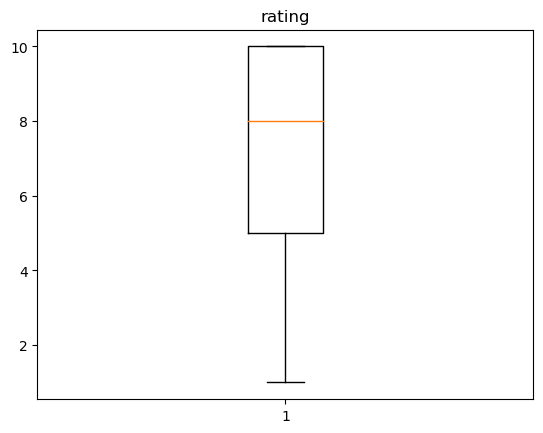

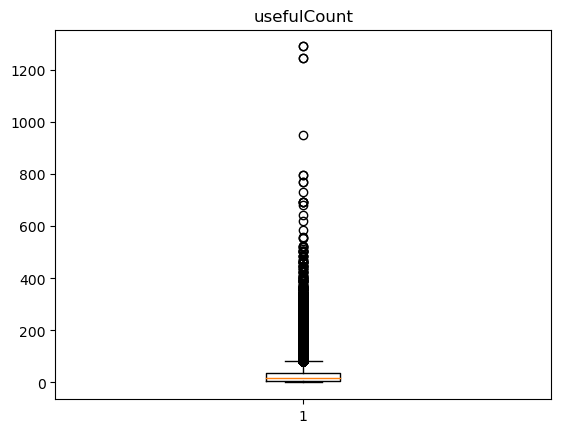

In [164]:
##plotting the boxplot to determine the outliers
numerical_columns = ['rating', 'usefulCount']  

for column in numerical_columns:
    plt.boxplot(df[column])
    plt.title(column)
    plt.show()


In [165]:
!pip install scipy

In [166]:
##determining the outliers

In [167]:
from scipy import stats

In [168]:
z_scores = np.abs(stats.zscore(df[numerical_columns]))

In [169]:
threshold = 3
outliers = np.where(z_scores > threshold)

In [170]:
for column_index, column_name in enumerate(numerical_columns):
    outlier_indices = outliers[0][np.where(outliers[1] == column_index)]
    print(f"Outliers in {column_name}: {outlier_indices}")

Outliers in rating: []
Outliers in usefulCount: [     1     66    312 ... 160331 160332 160350]


In [171]:
##deleting the outlier values

In [172]:
outlier_indices = outliers[0]

df.reset_index(drop=True, inplace=True)

df_filtered = df.drop(outlier_indices)


In [173]:
df_filtered.head()

,uniqueID,drugName,condition,review,rating,date,usefulCount
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combination of Bystolic 5 Mg and Fish Oil""",9,20-May-12,27
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, which had 21 pill cycle, and was very happy- very light periods, max 5 days, no other side effects. But it contained hormone gestodene, which is not available in US, so I switched to Lybrel, because the ingredients are similar. When my other pills ended, I started Lybrel immediately, on my first day of period, as the instructions said. And the period lasted for two weeks. When taking the second pack- same two weeks. And now, with third pack things got even worse- my third period lasted for two weeks and now it&#039;s the end of the third week- I still have daily brown discharge.\r\nThe positive side is that I didn&#039;t have any other side effects. The idea of being period free was so tempting... Alas.""",5,14-Dec-09,17
3,138000,Ortho Evra,Birth Control,"""This is my first time using any form of birth control. I&#039;m glad I went with the patch, I have been on it for 8 months. At first It decreased my libido but that subsided. The only downside is that it made my periods longer (5-6 days to be exact) I used to only have periods for 3-4 days max also made my cramps intense for the first two days of my period, I never had cramps before using birth control. Other than that in happy with the patch""",8,3-Nov-15,10
4,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around. I feel healthier, I&#039;m excelling at my job and I always have money in my pocket and my savings account. I had none of those before Suboxone and spent years abusing oxycontin. My paycheck was already spent by the time I got it and I started resorting to scheming and stealing to fund my addiction. All that is history. If you&#039;re ready to stop, there&#039;s a good chance that suboxone will put you on the path of great life again. I have found the side-effects to be minimal compared to oxycontin. I&#039;m actually sleeping better. Slight constipation is about it for me. It truly is amazing. The cost pales in comparison to what I spent on oxycontin.""",9,27-Nov-16,37
5,155963,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard erections however experianced headache, lower bowel preassure. 3rd day erections would wake me up &amp; hurt! Leg/ankles aches severe lower bowel preassure like you need to go #2 but can&#039;t! Enjoyed the initial rockhard erections but not at these side effects or $230 for months supply! I&#039;m 50 &amp; work out 3Xs a week. Not worth side effects!""",2,28-Nov-15,43


In [174]:
df_filtered.tail()

,uniqueID,drugName,condition,review,rating,date,usefulCount
160393,191035,Campral,Alcohol Dependence,"""I wrote my first report in Mid-October of 2014. I have not had any alcohol at all since that post, have reduced my dosage to 1 pill first thing in the morning. I am a very social person, and entertained a great deal. I was very very worried that I would relapse if faced with the availability of alcohol. I have sailed through all my seasonal parties, early spring get togethers and weekly &quot;wings and beer&quot; with friends with not one slip. My husband and daughter are huge supporters. As I write this, I have various wines and liquors in my cabinet - serve to guests - and have no interest at all in consuming booze in any form. Again, I state that Campral saved my life.""",10,31-May-15,125
160394,127085,Metoclopramide,Nausea/Vomiting,"""I was given this in IV before surgey. I immediately became anxious and could not sit still . The PA said &quot;oh yes this happens sometimes&quot;. They had to give me Benadryl to calm me down. It was the worst experience I have had -out of control and jumpy. """,1,1-Nov-11,34
160395,187382,Orencia,Rheumatoid Arthritis,"""Limited improvement after 4 months, developed bad rash and MD refused to continue medication.""",2,15-Mar-14,35
160396,47128,Thyroid desiccated,Underactive Thyroid,"""I&#039;ve been on thyroid medication 49 years, I spent my first 38 on Synthroid and various t4 formulas, I could not stand the up and down of Synthroid, it never was steady. Every time I went to the Dr. It was adjusted, it could not regulate me and most Dr&#039;s. Just played with raising and lowering the mg levels. \r\nFinally a person I new told me I should see her Dr. I did, and that was the beginning of a beautiful relationship with Armour Thyroid. I&#039;ve never felt better, my bad symptoms went away, and I feel almost human. It holds me steady for longer periods. sometimes the patient knows best, regardless of what the blood tests say. Armour contains unknown ingredients that can&#039;t be isolated into a synthetic pill form, Armour is natural, and best.""",10,19-Sep-15,79
160397,215220,Lubiprostone,"Constipation, Chronic","""I&#039;ve had chronic constipation all my adult life. Tried Linzess, it worked for a month then stopped. Doctor started me on Amitiza (24 mg) and it is a miracle. I&#039;ve been on for four months now. After a life of 7-10 days between bowel motions, I now go comfortably 3-4 times per week. No pain, very little gas. It&#039;s a miracle for me.""",9,13-Dec-14,116


In [175]:
##we now have the cleaned data as df_filtered

In [176]:
##now we perform summary stat
summary_stats = df_filtered.describe()
print(summary_stats)

            uniqueID         rating    usefulCount
count  157496.000000  157496.000000  157496.000000
mean   115874.489879  6.959129       24.994032    
std    67017.005701   3.280933       26.374424    
min    2.000000       1.000000       0.000000     
25%    58048.500000   4.000000       6.000000     
50%    115754.500000  8.000000       16.000000    
75%    173711.250000  10.000000      35.000000    
max    232291.000000  10.000000      137.000000   


In [177]:
df_filtered.head()

,uniqueID,drugName,condition,review,rating,date,usefulCount
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combination of Bystolic 5 Mg and Fish Oil""",9,20-May-12,27
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, which had 21 pill cycle, and was very happy- very light periods, max 5 days, no other side effects. But it contained hormone gestodene, which is not available in US, so I switched to Lybrel, because the ingredients are similar. When my other pills ended, I started Lybrel immediately, on my first day of period, as the instructions said. And the period lasted for two weeks. When taking the second pack- same two weeks. And now, with third pack things got even worse- my third period lasted for two weeks and now it&#039;s the end of the third week- I still have daily brown discharge.\r\nThe positive side is that I didn&#039;t have any other side effects. The idea of being period free was so tempting... Alas.""",5,14-Dec-09,17
3,138000,Ortho Evra,Birth Control,"""This is my first time using any form of birth control. I&#039;m glad I went with the patch, I have been on it for 8 months. At first It decreased my libido but that subsided. The only downside is that it made my periods longer (5-6 days to be exact) I used to only have periods for 3-4 days max also made my cramps intense for the first two days of my period, I never had cramps before using birth control. Other than that in happy with the patch""",8,3-Nov-15,10
4,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around. I feel healthier, I&#039;m excelling at my job and I always have money in my pocket and my savings account. I had none of those before Suboxone and spent years abusing oxycontin. My paycheck was already spent by the time I got it and I started resorting to scheming and stealing to fund my addiction. All that is history. If you&#039;re ready to stop, there&#039;s a good chance that suboxone will put you on the path of great life again. I have found the side-effects to be minimal compared to oxycontin. I&#039;m actually sleeping better. Slight constipation is about it for me. It truly is amazing. The cost pales in comparison to what I spent on oxycontin.""",9,27-Nov-16,37
5,155963,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard erections however experianced headache, lower bowel preassure. 3rd day erections would wake me up &amp; hurt! Leg/ankles aches severe lower bowel preassure like you need to go #2 but can&#039;t! Enjoyed the initial rockhard erections but not at these side effects or $230 for months supply! I&#039;m 50 &amp; work out 3Xs a week. Not worth side effects!""",2,28-Nov-15,43


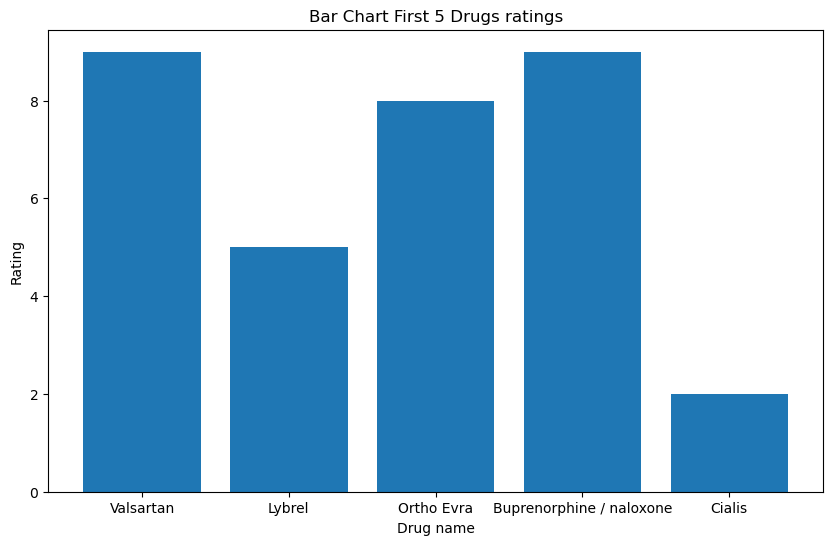

In [178]:
##first five drugs rating bar chart
column1 = df_filtered.head()['drugName']
column2 = df_filtered.head()['rating']

# Set the figure size
plt.figure(figsize=(10, 6))  # Adjust the values as per your requirement

plt.bar(column1, column2)
plt.xlabel('Drug name')
plt.ylabel('Rating')
plt.title('Bar Chart First 5 Drugs ratings')
plt.show()

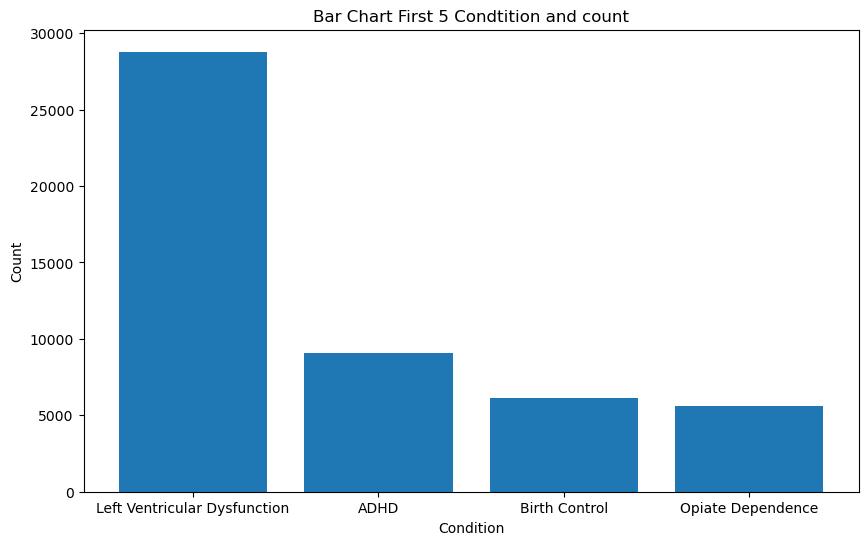

In [179]:

column1 = df.condition.head()
column2 = df.condition.value_counts().head()

# Set the figure size
plt.figure(figsize=(10, 6))  # Adjust the values as per your requirement

plt.bar(column1, column2)
plt.xlabel('Condition')
plt.ylabel('Count')
plt.title('Bar Chart First 5 Condtition and count')
plt.show()



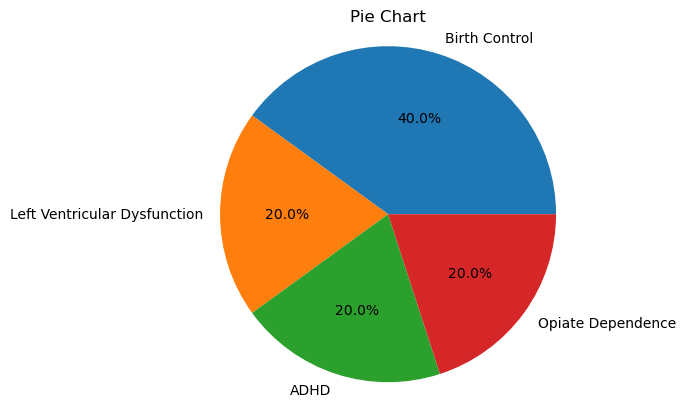

In [180]:
column = df.head()['condition']  

value_counts = column.value_counts()

plt.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%')
plt.title('Pie Chart')
plt.axis('equal')  
plt.show()

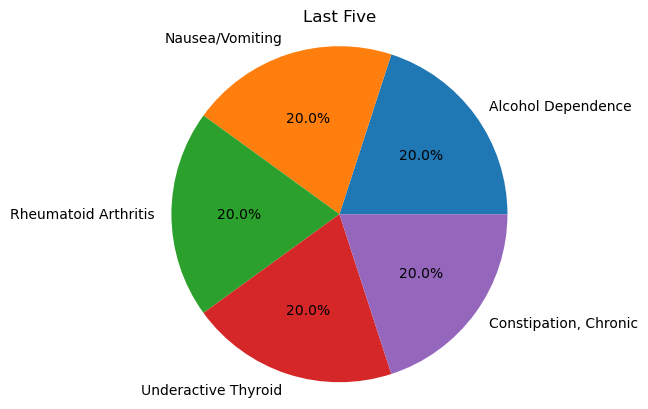

In [181]:
column = df.tail()['condition']  

value_counts = column.value_counts()

plt.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%')
plt.title('Last Five')
plt.axis('equal')  
plt.show()

In [182]:
##defining the feature data

In [183]:
df_train = df_filtered[(df_filtered['condition']=='Depression') | (df_filtered['condition']=='High Blood Pressure')|(df_filtered['condition']=='Diabetes, Type 2')]

In [184]:
df_filtered.shape

(157496, 7)

In [185]:
df_train.shape

(13343, 7)

In [186]:
df_train.head()

,uniqueID,drugName,condition,review,rating,date,usefulCount
11,75612,L-methylfolate,Depression,"""I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects.""",10,9-Mar-17,54
30,96233,Sertraline,Depression,"""1 week on Zoloft for anxiety and mood swings. I take 50mg in the mornings with my breakfast. Nausea on day one but that subsided as the week went on. I get the jitters about 2 hrs after taking it followed by yawning. I feel much better though and less angry/stressed.""",8,7-May-11,3
43,121333,Venlafaxine,Depression,"""my gp started me on Venlafaxine yesterday to help with depression and the change,a hour after taking them i was feeling very sick couldn,t stomach food or fluids, thought keep it up as she told me they did come with some side effects which would get better,took another one last night and was so ill i couldn,t stand ,being sick sweating shaking thought i was going to pass out. Did get some sleep hopeing to feel better this morning,took another one and felt so spaced out dry mouth shaking ,sick, so booked in to see gp again to make sure i should be feeling like this, only to find out she had put me on the wrong dose should have been on 37.5mg was put on 150mg, now on right dose hope this will be better""",4,27-Apr-16,3
49,156544,Dulaglutide,"Diabetes, Type 2","""Hey Guys, It&#039;s been 4 months since my last post as I wanted to give it a few months to see how this was going to work. So, I have been on Trulicity for six months now with Metformin. When I hit the five month period the diarrhea, gas, sulphur belching finally subsided. I now longer have any of those side effects. However, I still haven&#039;t lost any weight at all, but I think that was because when I first started Trulicity I was taking it with Glimepiride and that one has a side effect of weight gain so I think the two meds were fighting each other lol. I have been back on the Metformin with Trulicity for about a week now, so we will see what this does. I was diagnosed as stage 3 chronic kidney disease (CKD 3) so I am watching diet closely.""",10,24-Oct-17,24
80,171349,Wellbutrin,Depression,"""Started taking it and I slept well at night and awoke early around 5 to start my day happily. But come 8 am and I am drowsy and needed to take already two hrs nap. Awake and resume\r\r\nMy day with not much difficulties. Than st 2 pm again I needed a nap? So how was I gonna make it to work and my appointments too ? I went cold turkey. Felt much better after that. Only to crash again. I did try other anti depressants including pristique. But I suffered with insomnia with these meds. I know I need to start again but so confused if I should resume welbutrin""",4,13-Jan-17,15


In [187]:
X = df_train.drop(['uniqueID','drugName','rating','date','usefulCount'],axis=1)

In [188]:
X.head()

,condition,review
11,Depression,"""I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects."""
30,Depression,"""1 week on Zoloft for anxiety and mood swings. I take 50mg in the mornings with my breakfast. Nausea on day one but that subsided as the week went on. I get the jitters about 2 hrs after taking it followed by yawning. I feel much better though and less angry/stressed."""
43,Depression,"""my gp started me on Venlafaxine yesterday to help with depression and the change,a hour after taking them i was feeling very sick couldn,t stomach food or fluids, thought keep it up as she told me they did come with some side effects which would get better,took another one last night and was so ill i couldn,t stand ,being sick sweating shaking thought i was going to pass out. Did get some sleep hopeing to feel better this morning,took another one and felt so spaced out dry mouth shaking ,sick, so booked in to see gp again to make sure i should be feeling like this, only to find out she had put me on the wrong dose should have been on 37.5mg was put on 150mg, now on right dose hope this will be better"""
49,"Diabetes, Type 2","""Hey Guys, It&#039;s been 4 months since my last post as I wanted to give it a few months to see how this was going to work. So, I have been on Trulicity for six months now with Metformin. When I hit the five month period the diarrhea, gas, sulphur belching finally subsided. I now longer have any of those side effects. However, I still haven&#039;t lost any weight at all, but I think that was because when I first started Trulicity I was taking it with Glimepiride and that one has a side effect of weight gain so I think the two meds were fighting each other lol. I have been back on the Metformin with Trulicity for about a week now, so we will see what this does. I was diagnosed as stage 3 chronic kidney disease (CKD 3) so I am watching diet closely."""
80,Depression,"""Started taking it and I slept well at night and awoke early around 5 to start my day happily. But come 8 am and I am drowsy and needed to take already two hrs nap. Awake and resume\r\r\nMy day with not much difficulties. Than st 2 pm again I needed a nap? So how was I gonna make it to work and my appointments too ? I went cold turkey. Felt much better after that. Only to crash again. I did try other anti depressants including pristique. But I suffered with insomnia with these meds. I know I need to start again but so confused if I should resume welbutrin"""


In [189]:
X.review.value_counts()

"I have suffered from severe depression/anxiety for 9 years now. I also suffer from PTSD. I have tried almost everything out there, and Prozac is the only antidepressant that I can take and that works for me. I am very sensitive to medication, and I&#039;m glad I have found at least one medication that helps my severe depression. It helps motivate me and keeps me alive. I have been on 10 mg for a long time, and then recently went to 20 mg. I think I need to increase my dosage even more so. But it has been the only reliable medication I have ever taken, and for the longest duration."                                                                                                                                                                                                                                                                                                                                                                                                                           

In [190]:
X.head()

,condition,review
11,Depression,"""I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects."""
30,Depression,"""1 week on Zoloft for anxiety and mood swings. I take 50mg in the mornings with my breakfast. Nausea on day one but that subsided as the week went on. I get the jitters about 2 hrs after taking it followed by yawning. I feel much better though and less angry/stressed."""
43,Depression,"""my gp started me on Venlafaxine yesterday to help with depression and the change,a hour after taking them i was feeling very sick couldn,t stomach food or fluids, thought keep it up as she told me they did come with some side effects which would get better,took another one last night and was so ill i couldn,t stand ,being sick sweating shaking thought i was going to pass out. Did get some sleep hopeing to feel better this morning,took another one and felt so spaced out dry mouth shaking ,sick, so booked in to see gp again to make sure i should be feeling like this, only to find out she had put me on the wrong dose should have been on 37.5mg was put on 150mg, now on right dose hope this will be better"""
49,"Diabetes, Type 2","""Hey Guys, It&#039;s been 4 months since my last post as I wanted to give it a few months to see how this was going to work. So, I have been on Trulicity for six months now with Metformin. When I hit the five month period the diarrhea, gas, sulphur belching finally subsided. I now longer have any of those side effects. However, I still haven&#039;t lost any weight at all, but I think that was because when I first started Trulicity I was taking it with Glimepiride and that one has a side effect of weight gain so I think the two meds were fighting each other lol. I have been back on the Metformin with Trulicity for about a week now, so we will see what this does. I was diagnosed as stage 3 chronic kidney disease (CKD 3) so I am watching diet closely."""
80,Depression,"""Started taking it and I slept well at night and awoke early around 5 to start my day happily. But come 8 am and I am drowsy and needed to take already two hrs nap. Awake and resume\r\r\nMy day with not much difficulties. Than st 2 pm again I needed a nap? So how was I gonna make it to work and my appointments too ? I went cold turkey. Felt much better after that. Only to crash again. I did try other anti depressants including pristique. But I suffered with insomnia with these meds. I know I need to start again but so confused if I should resume welbutrin"""


In [191]:
# segregating dataframe for analyzing individual condition
X_dep=X[(X['condition']=='Depression')]
X_bp=X[(X['condition']=='High Blood Pressure')]
X_diab=X[(X['condition']=='Diabetes, Type 2')]

In [192]:
!pip install wordcloud

In [193]:
from wordcloud import WordCloud

Text(0.5, 1.0, 'Word cloud for Depression')

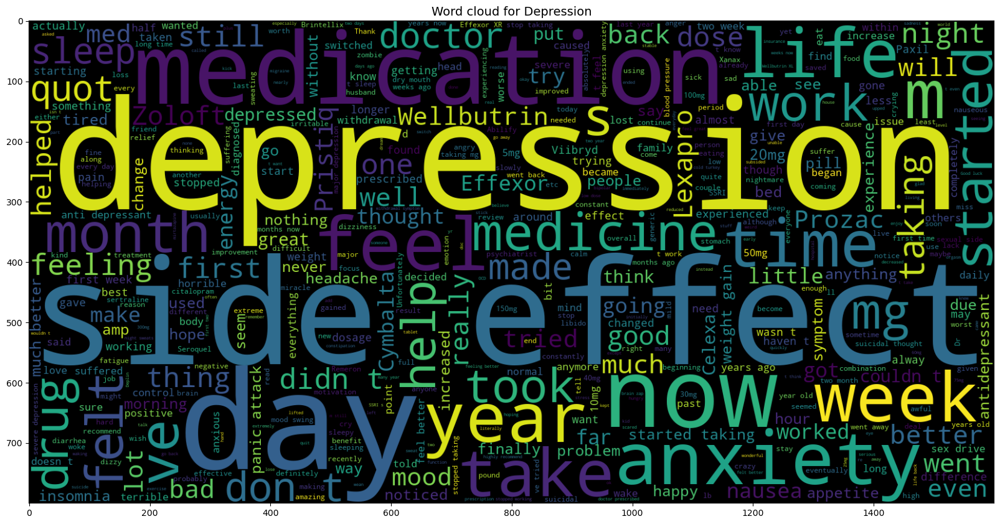

In [194]:
plt.figure(figsize = (20,20)) # Text that is Fake News Headlines
wc = WordCloud(max_words = 500 , width = 1600 , height = 800).generate(" ".join(X_dep.review))
plt.imshow(wc , interpolation = 'bilinear')
plt.title('Word cloud for Depression',fontsize=14)

Text(0.5, 1.0, 'Word cloud for High Blood Pressure')

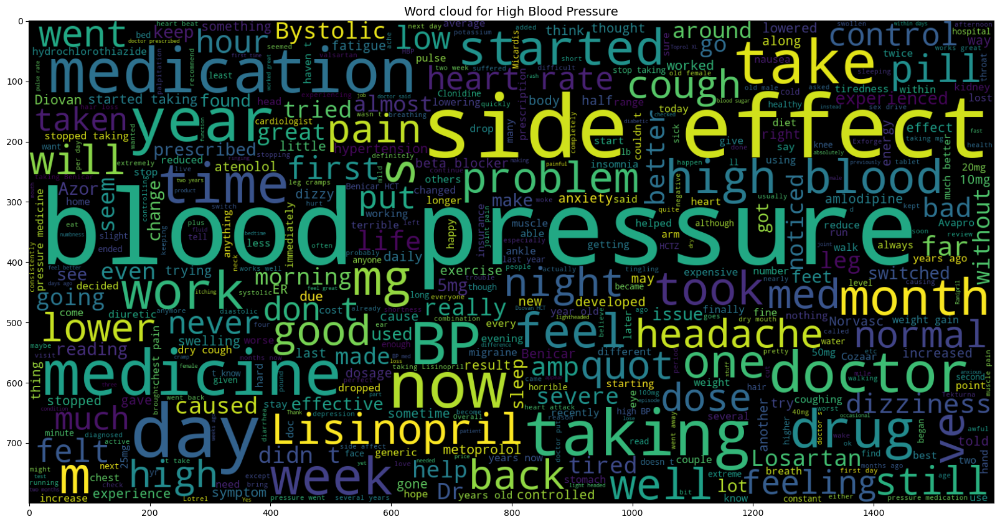

In [195]:
plt.figure(figsize = (20,20)) # Text that is Fake News Headlines
wc = WordCloud(max_words = 500 , width = 1600 , height = 800).generate(" ".join(X_bp.review))
plt.imshow(wc , interpolation = 'bilinear')
plt.title('Word cloud for High Blood Pressure',fontsize=14)

Text(0.5, 1.0, 'Word cloud for Diabetes Type 2')

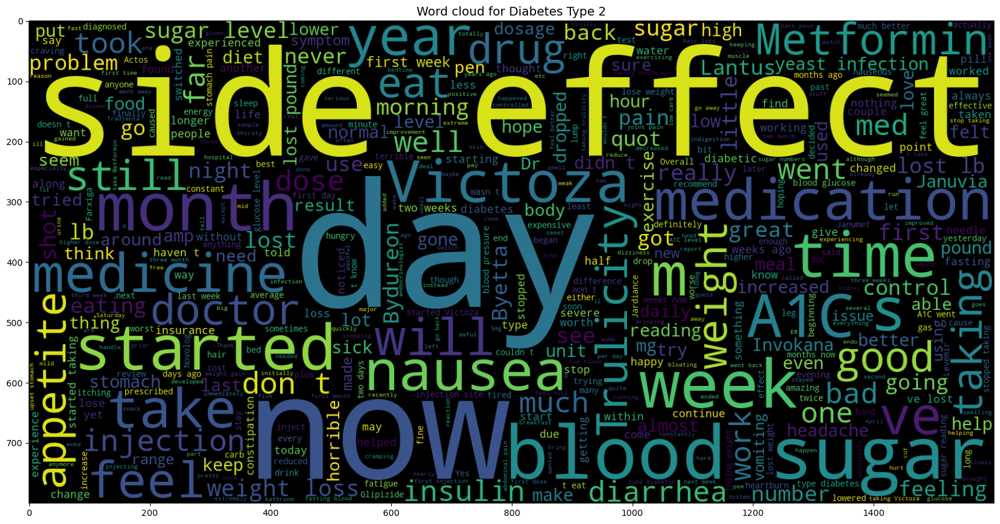

In [196]:
plt.figure(figsize = (20,20)) # Text that is Fake News Headlines
wc = WordCloud(max_words = 500 , width = 1600 , height = 800).generate(" ".join(X_diab.review))
plt.imshow(wc , interpolation = 'bilinear')
plt.title('Word cloud for Diabetes Type 2',fontsize=14)

In [197]:
for i, col in enumerate(X.columns):
    X.iloc[:, i] = X.iloc[:, i].str.replace('"', '')

In [198]:
# To set the width of the column to maximum
pd.set_option('max_colwidth', -1)

C:\Users\Delete.com\AppData\Local\Temp\ipykernel_8356\999061969.py:2: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('max_colwidth', -1)


In [199]:
X.head()

,condition,review
11,Depression,"I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects."
30,Depression,1 week on Zoloft for anxiety and mood swings. I take 50mg in the mornings with my breakfast. Nausea on day one but that subsided as the week went on. I get the jitters about 2 hrs after taking it followed by yawning. I feel much better though and less angry/stressed.
43,Depression,"my gp started me on Venlafaxine yesterday to help with depression and the change,a hour after taking them i was feeling very sick couldn,t stomach food or fluids, thought keep it up as she told me they did come with some side effects which would get better,took another one last night and was so ill i couldn,t stand ,being sick sweating shaking thought i was going to pass out. Did get some sleep hopeing to feel better this morning,took another one and felt so spaced out dry mouth shaking ,sick, so booked in to see gp again to make sure i should be feeling like this, only to find out she had put me on the wrong dose should have been on 37.5mg was put on 150mg, now on right dose hope this will be better"
49,"Diabetes, Type 2","Hey Guys, It&#039;s been 4 months since my last post as I wanted to give it a few months to see how this was going to work. So, I have been on Trulicity for six months now with Metformin. When I hit the five month period the diarrhea, gas, sulphur belching finally subsided. I now longer have any of those side effects. However, I still haven&#039;t lost any weight at all, but I think that was because when I first started Trulicity I was taking it with Glimepiride and that one has a side effect of weight gain so I think the two meds were fighting each other lol. I have been back on the Metformin with Trulicity for about a week now, so we will see what this does. I was diagnosed as stage 3 chronic kidney disease (CKD 3) so I am watching diet closely."
80,Depression,Started taking it and I slept well at night and awoke early around 5 to start my day happily. But come 8 am and I am drowsy and needed to take already two hrs nap. Awake and resume\r\r\nMy day with not much difficulties. Than st 2 pm again I needed a nap? So how was I gonna make it to work and my appointments too ? I went cold turkey. Felt much better after that. Only to crash again. I did try other anti depressants including pristique. But I suffered with insomnia with these meds. I know I need to start again but so confused if I should resume welbutrin


In [200]:
!pip install nltk

In [201]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Delete.com\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [202]:

from nltk.corpus import stopwords

stop = stopwords.words('english')


In [203]:
stop

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [204]:
from nltk.stem.snowball import SnowballStemmer

stemmer = SnowballStemmer("english")



In [205]:
!pip install bs4

In [206]:
from bs4 import BeautifulSoup
import re

In [207]:
def review_to_words(raw_review):
    # 1. Remove HTML tags
    review_text = BeautifulSoup(raw_review, "html.parser").get_text()
    # 2. Remove non-letters
    letters_only = re.sub("[^a-zA-Z]", " ", review_text)
    # 3. Convert to lower case and split into individual words
    words = letters_only.lower().split()
    # 4. Remove stop words
    meaningful_words = [w for w in words if not w in stop]
    # 5. Stemming
    stemmed_words = [stemmer.stem(word) for word in meaningful_words]
    
    return ' '.join(stemmed_words)

In [208]:
X['review_clean'] = X['review'].apply(review_to_words)

C:\Users\Delete.com\anaconda3\lib\site-packages\bs4\__init__.py:435: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  warnings.warn(


In [209]:
X.head()

,condition,review,review_clean
11,Depression,"I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects.",taken anti depress year improv most moder sever side affect make go take cymbalta most pain began deplin notic major improv overnight energi better disposit sink low low major depress take month feel like normal person first time ever best thing side effect
30,Depression,1 week on Zoloft for anxiety and mood swings. I take 50mg in the mornings with my breakfast. Nausea on day one but that subsided as the week went on. I get the jitters about 2 hrs after taking it followed by yawning. I feel much better though and less angry/stressed.,week zoloft anxieti mood swing take mg morn breakfast nausea day one subsid week went get jitter hrs take follow yawn feel much better though less angri stress
43,Depression,"my gp started me on Venlafaxine yesterday to help with depression and the change,a hour after taking them i was feeling very sick couldn,t stomach food or fluids, thought keep it up as she told me they did come with some side effects which would get better,took another one last night and was so ill i couldn,t stand ,being sick sweating shaking thought i was going to pass out. Did get some sleep hopeing to feel better this morning,took another one and felt so spaced out dry mouth shaking ,sick, so booked in to see gp again to make sure i should be feeling like this, only to find out she had put me on the wrong dose should have been on 37.5mg was put on 150mg, now on right dose hope this will be better",gp start venlafaxin yesterday help depress chang hour take feel sick stomach food fluid thought keep told come side effect would get better took anoth one last night ill stand sick sweat shake thought go pass get sleep hope feel better morn took anoth one felt space dri mouth shake sick book see gp make sure feel like find put wrong dose mg put mg right dose hope better
49,"Diabetes, Type 2","Hey Guys, It&#039;s been 4 months since my last post as I wanted to give it a few months to see how this was going to work. So, I have been on Trulicity for six months now with Metformin. When I hit the five month period the diarrhea, gas, sulphur belching finally subsided. I now longer have any of those side effects. However, I still haven&#039;t lost any weight at all, but I think that was because when I first started Trulicity I was taking it with Glimepiride and that one has a side effect of weight gain so I think the two meds were fighting each other lol. I have been back on the Metformin with Trulicity for about a week now, so we will see what this does. I was diagnosed as stage 3 chronic kidney disease (CKD 3) so I am watching diet closely.",hey guy month sinc last post want give month see go work trulic six month metformin hit five month period diarrhea gas sulphur belch final subsid longer side effect howev still lost weight think first start trulic take glimepirid one side effect weight gain think two med fight lol back metformin trulic week see diagnos stage chronic kidney diseas ckd watch diet close
80,Depression,Started taking it and I slept well at night and awoke early around 5 to start my day happily. But come 8 am and I am drowsy and needed to take already two hrs nap. Awake and resume\r\r\nMy day with not much difficulties. Than st 2 pm again I needed a nap? So how was I gonna make it to work and my appointments too ? I went cold turkey. Felt much better after that. Only to crash again. I did try other anti depressants including pristique. But I suffered with insomnia with these meds. I know I need to start again but s

In [210]:
X_feat=X['review_clean']
y=X['condition']

In [211]:
X_train, X_test, y_train, y_test = train_test_split(X_feat, y,stratify=y,test_size=0.2, random_state=0)

In [212]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    See full source and example: 
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
    
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [213]:
##bag of words

In [214]:
count_vectorizer = CountVectorizer(stop_words='english')

count_train = count_vectorizer.fit_transform(X_train)

count_test = count_vectorizer.transform(X_test)

In [215]:
count_train

<10674x8105 sparse matrix of type '<class 'numpy.int64'>'
	with 309909 stored elements in Compressed Sparse Row format>

In [216]:
##TFIDF

In [217]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf_vectorizer = TfidfVectorizer(stop_words='english', max_df=0.8)
tfidf_train_2 = tfidf_vectorizer.fit_transform(X_train)
tfidf_test_2 = tfidf_vectorizer.transform(X_test)

accuracy:   0.964
Confusion matrix, without normalization


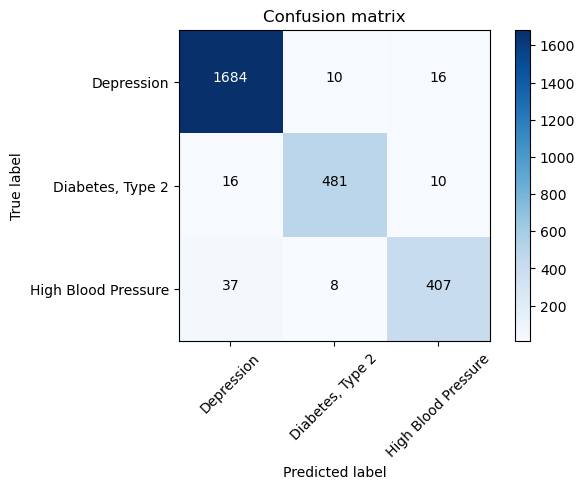

In [218]:
tfidf_vectorizer = TfidfVectorizer(stop_words='english', max_df=0.8)
tfidf_train = tfidf_vectorizer.fit_transform(X_train)
tfidf_test = tfidf_vectorizer.transform(X_test)

pass_tf = PassiveAggressiveClassifier()
pass_tf.fit(tfidf_train, y_train)
pred = pass_tf.predict(tfidf_test)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)
cm = metrics.confusion_matrix(y_test, pred, labels=[ 'Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=[ 'Depression','Diabetes, Type 2','High Blood Pressure'])


In [219]:
X.tail()

,condition,review,review_clean
160352,High Blood Pressure,It is fourth blood pressure pill for me. It feels like it is only partly working. My blood pressure problems are usually happening after anxiety attacks of which doctors says I have but don&#039;t know why.,fourth blood pressur pill feel like part work blood pressur problem usual happen anxieti attack doctor say know
160359,High Blood Pressure,"While on Bystolic my feet and arms were numb. My blood sugars became severely elevated from 112 glucose up to 249. This blood pressure pill is not a good choice for my diabetic condition. I was only on Bystolic for one week and now eight weeks later I am still suffering from foot and heel pain. However, going back on Vasotec my blood sugars have dropped back down to 112.",bystol feet arm numb blood sugar becam sever elev glucos blood pressur pill good choic diabet condit bystol one week eight week later still suffer foot heel pain howev go back vasotec blood sugar drop back
160379,"Diabetes, Type 2",I just got diagnosed with type 2. My doctor prescribed Invokana and metformin from the beginning. My sugars went down to normal by the second week. I am losing so much weight. No side effects yet. Miracle medicine for me,got diagnos type doctor prescrib invokana metformin begin sugar went normal second week lose much weight side effect yet miracl medicin
160387,Depression,"This is the third med I&#039;ve tried for anxiety and mild depression. Been on it for a week and I hate it so much. I am so dizzy, I have major diarrhea and feel worse than I started. Contacting my doc in the am and changing asap.",third med tri anxieti mild depress week hate much dizzi major diarrhea feel wors start contact doc chang asap
160391,High Blood Pressure,"I have only been on Tekturna for 9 days. The effect was immediate. I am also on a calcium channel blocker (Tiazac) and hydrochlorothiazide. I was put on Tekturna because of palpitations experienced with Diovan (ugly drug in my opinion, same company produces both however). The palpitations were pretty bad on Diovan, 24 hour monitor by EKG etc. After a few days of substituting Tekturna for Diovan, there are no more palpitations.",tekturna day effect immedi also calcium channel blocker tiazac hydrochlorothiazid put tekturna palpit experienc diovan ugli drug opinion compani produc howev palpit pretti bad diovan hour monitor ekg etc day substitut tekturna diovan palpit


In [220]:
##logic to recommend drug

In [221]:
def recommend_drug(df, target_illness):
    # Step 1: Filter the dataset to include only reviews related to the target illness
    filtered1_df = df[df['condition'].str.contains(target_illness, case=False)]
    
    # Step 2: Sort the filtered dataset based on useful count and rating
    sorted_df = filtered1_df.sort_values(by=['usefulCount', 'rating'], ascending=False)
    
    if sorted_df.empty:
        return None  # Return None if no matching reviews found
    
    # Step 3: Retrieve the drug associated with the top-ranked review
    recommended_drug = sorted_df.iloc[0]['drugName']
    
    return recommended_drug


In [222]:
df_filtered.tail()

,uniqueID,drugName,condition,review,rating,date,usefulCount
160393,191035,Campral,Alcohol Dependence,"""I wrote my first report in Mid-October of 2014. I have not had any alcohol at all since that post, have reduced my dosage to 1 pill first thing in the morning. I am a very social person, and entertained a great deal. I was very very worried that I would relapse if faced with the availability of alcohol. I have sailed through all my seasonal parties, early spring get togethers and weekly &quot;wings and beer&quot; with friends with not one slip. My husband and daughter are huge supporters. As I write this, I have various wines and liquors in my cabinet - serve to guests - and have no interest at all in consuming booze in any form. Again, I state that Campral saved my life.""",10,31-May-15,125
160394,127085,Metoclopramide,Nausea/Vomiting,"""I was given this in IV before surgey. I immediately became anxious and could not sit still . The PA said &quot;oh yes this happens sometimes&quot;. They had to give me Benadryl to calm me down. It was the worst experience I have had -out of control and jumpy. """,1,1-Nov-11,34
160395,187382,Orencia,Rheumatoid Arthritis,"""Limited improvement after 4 months, developed bad rash and MD refused to continue medication.""",2,15-Mar-14,35
160396,47128,Thyroid desiccated,Underactive Thyroid,"""I&#039;ve been on thyroid medication 49 years, I spent my first 38 on Synthroid and various t4 formulas, I could not stand the up and down of Synthroid, it never was steady. Every time I went to the Dr. It was adjusted, it could not regulate me and most Dr&#039;s. Just played with raising and lowering the mg levels. \r\nFinally a person I new told me I should see her Dr. I did, and that was the beginning of a beautiful relationship with Armour Thyroid. I&#039;ve never felt better, my bad symptoms went away, and I feel almost human. It holds me steady for longer periods. sometimes the patient knows best, regardless of what the blood tests say. Armour contains unknown ingredients that can&#039;t be isolated into a synthetic pill form, Armour is natural, and best.""",10,19-Sep-15,79
160397,215220,Lubiprostone,"Constipation, Chronic","""I&#039;ve had chronic constipation all my adult life. Tried Linzess, it worked for a month then stopped. Doctor started me on Amitiza (24 mg) and it is a miracle. I&#039;ve been on for four months now. After a life of 7-10 days between bowel motions, I now go comfortably 3-4 times per week. No pain, very little gas. It&#039;s a miracle for me.""",9,13-Dec-14,116


In [223]:
!pip install gradio

In [224]:
# import gradio as gr

def finalPredict(input_text):
    text = [input_text]
    test = tfidf_vectorizer.transform(text)
    predict1 = pass_tf.predict(test)[0]
    ill = recommend_drug(df_filtered, predict1)
    return f"Base on the information you provided, your condition is:{predict1}. You are recommended to use: {ill}."


import gradio as gr

with gr.Blocks(css=".gradio-container {background: url('file=drug.jpg'); background-repeat: no-repeat; background-size: cover; background-position: center; opacity:0.7;} .main{margin: 300px 200px 300px 200px;} .lg{width: 100px;}") as demo:
    
    name = gr.Textbox(label="Enter review here")
    output = gr.Textbox(label="Predicted condition and recommended drug")
    greet_btn = gr.Button("Submit")
    greet_btn.click(fn=finalPredict, inputs=name, outputs=output, api_name="finalPredict")


demo.launch(inbrowser=True)

Running on local URL:  http://127.0.0.1:7897

To create a public link, set `share=True` in `launch()`.
